In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import os

import matplotlib.pyplot as plt
import seaborn as sn
import streamlit as st

## Prepare data used for the website

First show the visualization results before moving to the web

In [2]:
os.getcwd()

'/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/advise/visualization'

In [3]:
data_pth = "/Users/diyi93/Dropbox/ADVISE Results/Results2021/output/combined"
file_names = ["ED_Medium_1_combined.csv",
              "ED_Medium_2_combined.csv",
              "ED_Medium_3_combined.csv",
              "ED_Medium_4_combined.csv",
              "LOTTR_Medium_1_combined.csv",
              "LOTTR_Medium_2_combined.csv",
              "LOTTR_Medium_3_combined.csv",
              "LOTTR_Medium_4_combined.csv",
              "TTTR_Medium_1_combined.csv",
              "TTTR_Medium_2_combined.csv",
              "TTTR_Medium_3_combined.csv",
              "TTTR_Medium_4_combined.csv",
             ]
link_pth = "/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/Data/gis"
shp_names = ["TN/Tennessee.shp",
             "states/Georgia.shp",
             "states/Alabama.shp",
             "states/Arkansas.shp",
             "states/Mississippi.shp",
             "states/Kentucky.shp"
           ]

tmc_pth = "/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/Data/NPMRDS"
tmc_fn = "TMC_Identification.csv"

## Load tmc links by region

In [4]:
fn_lst = []
for fn in file_names[0:4]:
    fn_lst.append(pd.read_csv(os.path.join(data_pth, fn)))
ED_df = pd.concat(fn_lst)

In [5]:
fn_lst = []
for fn in file_names[4:8]:
    fn_lst.append(pd.read_csv(os.path.join(data_pth, fn)))
LOTTR_df = pd.concat(fn_lst)

In [6]:
fn_lst = []
for fn in file_names[8:12]:
    fn_lst.append(pd.read_csv(os.path.join(data_pth, fn)))
TTTR_df = pd.concat(fn_lst)

In [7]:
# get tmc lists
tmc_dict = {}
# region_names = ['Knoxville', 'Chattanooga', 'Nashville', 'Memphis']
for i, df_temp in enumerate(fn_lst, 1):
    tmc_dict[int(i)] = df_temp['tmc'].to_list()

## Load links

In [8]:
links_lst = []
for shp_n in shp_names:
    links_lst.append(gpd.read_file(os.path.join(link_pth, shp_n)))
links_df = pd.concat(links_lst)

<AxesSubplot:>

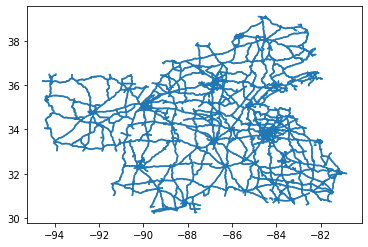

In [9]:
links_df.plot()

In [10]:
# get the tmc list for each region
tmc_df = pd.read_csv(os.path.join(tmc_pth, tmc_fn))
display(tmc_df.head())

,tmc,road,direction,intersection,state,county,zip,start_latitude,start_longitude,end_latitude,...,aadt_singl,aadt_combi,nhs,nhs_pct,strhnt_typ,strhnt_pct,truck,isprimary,active_start_date,active_end_date
0,121P04191,I-40/I-65,SOUTHBOUND,I-65/EXIT 210,TN,DAVIDSON,37203,36.14835,-86.78022,36.14830,...,8327,2776,1,100,1,100,1,1,2021-01-01 00:00:00-05:00,NaN
1,121P04190,I-40/I-65,SOUTHBOUND,DEMONBREUN ST/EXIT 209,TN,DAVIDSON,37203,36.15260,-86.78731,36.15068,...,8421,2807,1,100,1,100,1,1,2021-01-01 00:00:00-05:00,NaN
2,121P04193,I-24/I-40,WESTBOUND,FESSLERS LN/EXIT 212,TN,DAVIDSON,37210,36.14720,-86.74367,36.14840,...,9008,3603,1,100,1,100,1,1,2021-01-01 00:00:00-05:00,NaN
3,121P04192,I-24/I-40,WESTBOUND,I-24/I-40,TN,DAVIDSON,37210,36.14122,-86.73162,36.14165,...,7889,3155,1,100,1,100,1,1,2021-01-01 00:00:00-05:00,NaN
4,121P04199,I-40,EASTBOUND,TERMINAL DR/EXIT 216,TN,DAVIDSON,37214,36.14200,-86.67814,36.14171,...,7848,3130,1,100,1,100,1,1,2021-01-01 00:00:00-05:00,NaN


In [11]:
links_df.head()

,Tmc,TmcType,RoadNumber,RoadName,IsPrimary,FirstName,TmcLinear,Country,State,County,...,AltRteName,AADT,AADT_Singl,AADT_Combi,NHS,NHS_Pct,Strhnt_Typ,Strhnt_Pct,Truck,geometry
0,121+05811,P1,US-45,S HIGHLAND AVE,1,US-70/TN-1/E Sycamore St,526,UNITED STATES,TENNESSEE,MADISON,...,45,26749,5609,1335,1,100,0,0,1,"LINESTRING (-88.81411 35.60300, -88.81431 35.6..."
1,113+05343,P1,US-64,US-64,1,N Houston Levee Rd/Canada Rd,415,UNITED STATES,TENNESSEE,SHELBY,...,64,63660,8912,1909,1,100,0,0,1,"LINESTRING (-89.74092 35.20480, -89.73924 35.2..."
2,121+05841,P1,TN-22,TN-22,1,US-45W/Section Line Rd,527,UNITED STATES,TENNESSEE,OBION,...,51,9900,2871,396,1,100,0,0,1,"LINESTRING (-89.04405 36.44599, -89.04231 36.4..."
3,121+05973,P1,US-412,US-412,1,US-43/US-412-BR/TN-6/TN-99,524,UNITED STATES,TENNESSEE,MAURY,...,412,17641,1908,528,1,100,0,0,1,"LINESTRING (-87.10565 35.62819, -87.10712 35.6..."
4,121+06104,P1,I-40,I-40,1,Campbell St/Exit 83,112,UNITED STATES,TENNESSEE,MADISON,...,40,55640,11128,2782,1,100,1,100,1,"LINESTRING (-88.82619 35.67123, -88.82595 35.6..."


In [12]:
# select only the important tmcs
links = links_df.loc[links_df.Tmc.isin(tmc_df.tmc) , :].copy()
print(links.shape)

(8441, 37)


<AxesSubplot:>

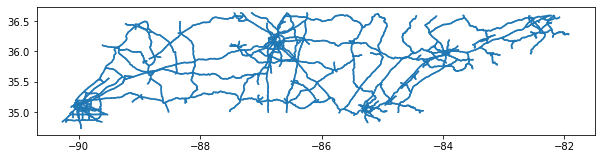

In [13]:
# save
fig, ax = plt.subplots(figsize=(10, 6))
links.plot(ax=ax)

In [14]:
# prepare links for each tmc
links_by_region = {}
for i in range(1,5):
    filt = links.Tmc.isin(tmc_dict[int(i)])
    links_by_region[int(i)] = links.loc[filt, :].copy()

<AxesSubplot:>

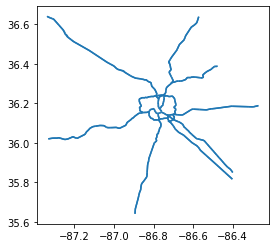

In [15]:
links_by_region[3].plot()

### join with travel reliability data and plot

In [17]:
pd.set_option('display.max_columns', None)
final_df = pd.merge(links_df, LOTTR_df.add_suffix('_lottr'), left_on='Tmc', right_on='tmc_lottr', how='inner')
final_df = pd.merge(final_df, TTTR_df.add_suffix('_tttr'), left_on='Tmc', right_on='tmc_tttr', how='inner')
final_df = pd.merge(final_df, ED_df.add_suffix('_ed'), left_on='Tmc', right_on='tmc_ed', how='inner')
final_df = final_df.drop(['tmc_lottr', 'tmc_tttr', 'tmc_ed'], axis=1)

In [20]:
# add start end (lon, lat) pairs
final_df['start'] = final_df['StartLong'].astype(str) + ',' + final_df['StartLat'].astype(str)
final_df['end'] = final_df['EndLong'].astype(str) + ',' + final_df['EndLat'].astype(str)

In [21]:
# restore their metropolitan region
final_df['met_region'] = None
for i in range(1, 5):
    filt = final_df['Tmc'].isin(tmc_dict[int(i)])
    final_df.loc[filt, 'met_region'] = i

final_df.head()

,Tmc,TmcType,RoadNumber,RoadName,IsPrimary,FirstName,TmcLinear,Country,State,County,Zip,Direction,StartLat,StartLong,EndLat,EndLong,Miles,FRC,Border_Set,F_System,Urban_Code,FacilType,StrucType,ThruLanes,Route_Numb,Route_Sign,Route_Qual,AltRteName,AADT,AADT_Singl,AADT_Combi,NHS,NHS_Pct,Strhnt_Typ,Strhnt_Pct,Truck,geometry,Jan._lottr,Feb._lottr,Mar._lottr,Q1_lottr,Jan._tttr,Feb._tttr,Mar._tttr,Q1_tttr,Jan._ed,Feb._ed,Mar._ed,start,end,met_region
0,121+06104,P1,I-40,I-40,1,Campbell St/Exit 83,112,UNITED STATES,TENNESSEE,MADISON,38305,E,35.67123,-88.82619,35.67335,-88.81366,0.718272,1,N,1,42265,2,NaN,4.0,40.0,2.0,1.0,40,55640,11128,2782,1,100,1,100,1,"LINESTRING (-88.82619 35.67123, -88.82595 35.6...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,"-88.82619,35.67123","-88.81366,35.67335",4
1,113-04442,P1,I-240,I-240,1,I-55/Exit 25,78,UNITED STATES,TENNESSEE,SHELBY,38106,S,35.07705,-90.02641,35.07694,-90.02647,0.008322,2,N,1,56116,2,1.0,6.0,240.0,2.0,1.0,240,101160,4046,3034,1,100,1,100,1,"LINESTRING (-90.02641 35.07705, -90.02647 35.0...",1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.00,0.00,0.00,"-90.02641,35.07705","-90.02647,35.07694",4
2,113-04252,P1,TN-385,TN-385,1,Raleigh-Millington Rd,84,UNITED STATES,TENNESSEE,SHELBY,38053,E,35.33057,-89.91636,35.33022,-89.90340,0.730896,2,N,2,56116,2,NaN,4.0,385.0,4.0,1.0,385,10320,1032,412,1,100,2,100,0,"LINESTRING (-89.91636 35.33057, -89.91596 35.3...",1.133333,1.248936,1.161364,1.155556,1.565217,1.741489,3.054545,1.767021,72.43,68.32,208.62,"-89.91636,35.33057","-89.9034,35.33022",4
3,121+04474,P1,I-65,I-65,1,TN-96/Murfreesboro Rd/Exit 65,87,UNITED STATES,TENNESSEE,WILLIAMSON,37064,N,35.86738,-86.83118,35.91052,-86.82462,3.013666,1,N,1,61273,2,NaN,8.0,65.0,2.0,1.0,65,102140,10214,1021,1,100,1,100,1,"LINESTRING (-86.83118 35.86738, -86.83104 35.8...",1.026144,1.051613,1.032680,1.032468,1.089172,1.424528,1.096154,1.199363,14.85,68.25,1410.37,"-86.83118,35.86738","-86.82462,35.91052",3
4,121+04516,P1,I-40,I-40,1,US-70/Exit 239,121,UNITED STATES,TENNESSEE,WILSON,37087,E,36.18223,-86.29608,36.18775,-86.27064,1.469569,1,N,1,61273,2,NaN,4.0,40.0,2.0,1.0,40,52890,12164,1057,1,100,1,100,1,"LINESTRING (-86.29608 36.18223, -86.29551 36.1...",1.025641,1.051282,1.038961,1.025641,1.063291,1.333333,1.181818,1.113924,0.00,10.20,0.00,"-86.29608,36.18223","-86.27064,36.18775",3


In [22]:
print(final_df.geometry[0])

LINESTRING (-88.82619 35.67123, -88.82595000000001 35.67127, -88.82545 35.67134, -88.82529 35.67137, -88.82317 35.67173, -88.81956 35.67234, -88.81366 35.67335)


In [23]:
os.getcwd()

'/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/advise/visualization'

# Plot LOTTR

<AxesSubplot:>

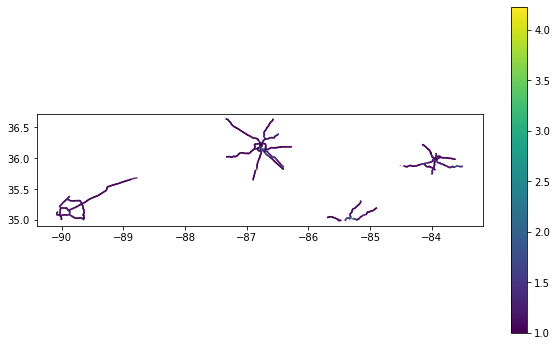

In [24]:
fig, ax = plt.subplots(figsize=(10, 6))
final_df.plot(ax=ax, column = 'Mar._lottr', legend=True)

In [25]:
import pydeck as pdk

In [26]:
final_df.head()
final_df['elevation'] = final_df['Mar._lottr'].replace(np.nan, 0)
final_df['elevation'] = final_df['elevation'].apply(lambda x:round(x,2))

In [27]:
print(tuple(final_df.iloc[0].geometry.coords))

((-88.82619, 35.67123), (-88.82595, 35.67127), (-88.82545, 35.67134), (-88.82529, 35.67137), (-88.82317, 35.67173), (-88.81956, 35.67234), (-88.81366, 35.67335))


In [28]:
def linestring2coords(x):
    # return points of the linestring
    return tuple(x['geometry'].coords)

# get color based on value
def get_color(x, col_name, xmin, xmax):
    import matplotlib
    import matplotlib.cm as cm
    norm = matplotlib.colors.Normalize(vmin=xmin, vmax=xmax, clip=True)
    mapper = cm.ScalarMappable(norm=norm, cmap=cm.plasma)
    if np.isnan(x[col_name]):
        return (100.0,100.0,100.0)
    txt = list(mapper.to_rgba(x[col_name])[:-1])
    txt = tuple(255*item for item in txt)
    return txt

In [29]:
final_df['color_lottr'] = final_df.apply(get_color, args=('Mar._lottr', 1, 1.5), axis=1)
final_df['MidLat'] = (final_df['StartLat'] + final_df['EndLat'])/2
final_df['MidLong']= (final_df['StartLong'] + final_df['EndLong'])/2

In [30]:
final_df['path'] = final_df.apply(linestring2coords, axis=1)
final_df.head()

,Tmc,TmcType,RoadNumber,RoadName,IsPrimary,FirstName,TmcLinear,Country,State,County,Zip,Direction,StartLat,StartLong,EndLat,EndLong,Miles,FRC,Border_Set,F_System,Urban_Code,FacilType,StrucType,ThruLanes,Route_Numb,Route_Sign,Route_Qual,AltRteName,AADT,AADT_Singl,AADT_Combi,NHS,NHS_Pct,Strhnt_Typ,Strhnt_Pct,Truck,geometry,Jan._lottr,Feb._lottr,Mar._lottr,Q1_lottr,Jan._tttr,Feb._tttr,Mar._tttr,Q1_tttr,Jan._ed,Feb._ed,Mar._ed,start,end,met_region,elevation,color_lottr,MidLat,MidLong,path
0,121+06104,P1,I-40,I-40,1,Campbell St/Exit 83,112,UNITED STATES,TENNESSEE,MADISON,38305,E,35.67123,-88.82619,35.67335,-88.81366,0.718272,1,N,1,42265,2,NaN,4.0,40.0,2.0,1.0,40,55640,11128,2782,1,100,1,100,1,"LINESTRING (-88.82619 35.67123, -88.82595 35.6...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,"-88.82619,35.67123","-88.81366,35.67335",4,0.00,"(100.0, 100.0, 100.0)",35.672290,-88.819925,"((-88.82619, 35.67123), (-88.82595, 35.67127),..."
1,113-04442,P1,I-240,I-240,1,I-55/Exit 25,78,UNITED STATES,TENNESSEE,SHELBY,38106,S,35.07705,-90.02641,35.07694,-90.02647,0.008322,2,N,1,56116,2,1.0,6.0,240.0,2.0,1.0,240,101160,4046,3034,1,100,1,100,1,"LINESTRING (-90.02641 35.07705, -90.02647 35.0...",1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.00,0.00,0.00,"-90.02641,35.07705","-90.02647,35.07694",4,1.00,"(12.847665, 7.599765, 134.633625)",35.076995,-90.026440,"((-90.02641, 35.07705), (-90.02647, 35.07694))"
2,113-04252,P1,TN-385,TN-385,1,Raleigh-Millington Rd,84,UNITED STATES,TENNESSEE,SHELBY,38053,E,35.33057,-89.91636,35.33022,-89.90340,0.730896,2,N,2,56116,2,NaN,4.0,385.0,4.0,1.0,385,10320,1032,412,1,100,2,100,0,"LINESTRING (-89.91636 35.33057, -89.91596 35.3...",1.133333,1.248936,1.161364,1.155556,1.565217,1.741489,3.054545,1.767021,72.43,68.32,208.62,"-89.91636,35.33057","-89.9034,35.33022",4,1.16,"(151.727805, 19.683449999999997, 160.118835)",35.330395,-89.909880,"((-89.91636, 35.33057), (-89.91596, 35.33056),..."
3,121+04474,P1,I-65,I-65,1,TN-96/Murfreesboro Rd/Exit 65,87,UNITED STATES,TENNESSEE,WILLIAMSON,37064,N,35.86738,-86.83118,35.91052,-86.82462,3.013666,1,N,1,61273,2,NaN,8.0,65.0,2.0,1.0,65,102140,10214,1021,1,100,1,100,1,"LINESTRING (-86.83118 35.86738, -86.83104 35.8...",1.026144,1.051613,1.032680,1.032468,1.089172,1.424528,1.096154,1.199363,14.85,68.25,1410.37,"-86.83118,35.86738","-86.82462,35.91052",3,1.03,"(49.31037, 4.680269999999999, 150.53415)",35.888950,-86.827900,"((-86.83118, 35.86738), (-86.83104, 35.86937),..."
4,121+04516,P1,I-40,I-40,1,US-70/Exit 239,121,UNITED STATES,TENNESSEE,WILSON,37087,E,36.18223,-86.29608,36.18775,-86.27064,1.469569,1,N,1,61273,2,NaN,4.0,40.0,2.0,1.0,40,52890,12164,1057,1,100,1,100,1,"LINESTRING (-86.29608 36.18223, -86.29551 36.1...",1.025641,1.051282,1.038961,1.025641,1.063291,1.333333,1.181818,1.113924,0.00,10.20,0.00,"-86.29608,36.18223","-86.27064,36.18775",3,1.04,"(54.65925, 4.3281149999999995, 152.80594499999...",36.184990,-86.283360,"((-86.29608, 36.18223), (-86.29551, 36.18228),..."


In [31]:
layer = pdk.Layer("ColumnLayer",
                  data=final_df, # final_df
                  # id='ColumnLayer',
                  get_position=['MidLong', 'MidLat'],
                  get_elevation="elevation",
                  get_color="color_lottr",
                  elevation_scale=50000,
                  radius=1000,
                  # radius_min_pixels=2,
                  get_fill_color="color_lottr",  # Set an RGBA value for fill
                  extruded=True,
                  pickable=True,
                  stroked=True,
                  filled=True,
                  auto_highlight=True,
                  wireframe=False,
                  opacity=1.0)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=-86.5,
    latitude=36,
    zoom=6,
    min_zoom=5,
    max_zoom=15,
    pitch=30,
    bearing=0)


tooltip = {'html': '<b>Elevation Value:</b> LOTTR: {elevation}',
           'style': {'color': 'white'}
          }
pdk.Deck([layer], initial_view_state=view_state,
         tooltip=tooltip,
         map_style=pdk.map_styles.ROAD,
        ).to_html("geopandas_integration.html")

In [32]:
# line_layer = pdk.Layer(
#     type="GeoJsonLayer",
#     data=final_json,  # local url
#     get_position = "geometry.coordinates",
#     # get_color=GET_COLOR_JS,
#     get_width=100,
#     get_fill_color=[255, 255, 255],
#     get_line_color=[255, 255, 255],
#     auto_highlight=True,
#     pickable=True
# )

path_layer = pdk.Layer(
    type="PathLayer",
    data=final_df,  # local url
    get_path="path",
    # get_color=GET_COLOR_JS,
    # width_scale=10,
    width_min_pixels=4,
    get_color="color_lottr",
    auto_highlight=True,
    pickable=True,
    filled=True,
    opacity=0.8
)

# Set the viewport location
view_state = pdk.ViewState(
    longitude=-86.5,
    latitude=36,
    zoom=6.5,
    min_zoom=5,
    max_zoom=15,
    pitch=0,
    bearing=0)

tooltip = {'html': '<b>Elevation Value:</b> LOTTR: {elevation}',
           'style': {'color': 'white'}
          }

pdk.Deck([path_layer], initial_view_state=view_state,
         map_style=pdk.map_styles.ROAD,
         tooltip = tooltip
         ).to_html("geopandas_integration.html")

In [33]:
os.getcwd()

'/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/advise/visualization'

In [34]:
# store geodataframe as pickle
final_df.to_csv(os.path.join(link_pth, "advise_2021Q1.csv"), index=False)

In [35]:
final_df.to_csv(os.path.join(os.getcwd(), "advise_2021Q1.csv"), index=False)

In [65]:
os.path.join(link_pth, 'advise_2021Q1.csv')

'/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/Data/gis/advise_2021Q1.csv'

In [67]:
df_test = pd.read_csv(os.path.join(link_pth, 'advise_2021Q1.csv'))
df_test.head()

,Tmc,TmcType,RoadNumber,RoadName,IsPrimary,FirstName,TmcLinear,Country,State,County,Zip,Direction,StartLat,StartLong,EndLat,EndLong,Miles,FRC,Border_Set,F_System,Urban_Code,FacilType,StrucType,ThruLanes,Route_Numb,Route_Sign,Route_Qual,AltRteName,AADT,AADT_Singl,AADT_Combi,NHS,NHS_Pct,Strhnt_Typ,Strhnt_Pct,Truck,geometry,Jan._lottr,Feb._lottr,Mar._lottr,Q1_lottr,Jan._tttr,Feb._tttr,Mar._tttr,Q1_tttr,Jan._ed,Feb._ed,Mar._ed,start,end,elevation,color_lottr,path,MidLat,MidLong
0,121+06104,P1,I-40,I-40,1,Campbell St/Exit 83,112,UNITED STATES,TENNESSEE,MADISON,38305,E,35.67123,-88.82619,35.67335,-88.81366,0.718272,1,N,1,42265,2,NaN,4.0,40.0,2.0,1.0,40,55640,11128,2782,1,100,1,100,1,"LINESTRING (-88.82619 35.67123, -88.8259500000...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,"-88.82619,35.67123","-88.81366,35.67335",0.00,"(100.0, 100.0, 100.0)","((-88.82619, 35.67123), (-88.82595, 35.67127),...",35.672290,-88.819925
1,113-04442,P1,I-240,I-240,1,I-55/Exit 25,78,UNITED STATES,TENNESSEE,SHELBY,38106,S,35.07705,-90.02641,35.07694,-90.02647,0.008322,2,N,1,56116,2,1.0,6.0,240.0,2.0,1.0,240,101160,4046,3034,1,100,1,100,1,"LINESTRING (-90.02641 35.07705, -90.02647 35.0...",1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.00,0.00,0.00,"-90.02641,35.07705","-90.02647,35.07694",1.00,"(12.847665, 7.599765, 134.633625)","((-90.02641, 35.07705), (-90.02647, 35.07694))",35.076995,-90.026440
2,113-04252,P1,TN-385,TN-385,1,Raleigh-Millington Rd,84,UNITED STATES,TENNESSEE,SHELBY,38053,E,35.33057,-89.91636,35.33022,-89.90340,0.730896,2,N,2,56116,2,NaN,4.0,385.0,4.0,1.0,385,10320,1032,412,1,100,2,100,0,"LINESTRING (-89.91636 35.33057, -89.91596 35.3...",1.133333,1.248936,1.161364,1.155556,1.565217,1.741489,3.054545,1.767021,72.43,68.32,208.62,"-89.91636,35.33057","-89.9034,35.33022",1.16,"(151.727805, 19.683449999999997, 160.118835)","((-89.91636, 35.33057), (-89.91596, 35.33056),...",35.330395,-89.909880
3,121+04474,P1,I-65,I-65,1,TN-96/Murfreesboro Rd/Exit 65,87,UNITED STATES,TENNESSEE,WILLIAMSON,37064,N,35.86738,-86.83118,35.91052,-86.82462,3.013666,1,N,1,61273,2,NaN,8.0,65.0,2.0,1.0,65,102140,10214,1021,1,100,1,100,1,"LINESTRING (-86.83118 35.86738, -86.83104 35.8...",1.026144,1.051613,1.032680,1.032468,1.089172,1.424528,1.096154,1.199363,14.85,68.25,1410.37,"-86.83118,35.86738","-86.82462,35.91052",1.03,"(49.31037, 4.680269999999999, 150.53415)","((-86.83118, 35.86738), (-86.83104, 35.86937),...",35.888950,-86.827900
4,121+04516,P1,I-40,I-40,1,US-70/Exit 239,121,UNITED STATES,TENNESSEE,WILSON,37087,E,36.18223,-86.29608,36.18775,-86.27064,1.469569,1,N,1,61273,2,NaN,4.0,40.0,2.0,1.0,40,52890,12164,1057,1,100,1,100,1,"LINESTRING (-86.29608 36.18223, -86.2955099999...",1.025641,1.051282,1.038961,1.025641,1.063291,1.333333,1.181818,1.113924,0.00,10.20,0.00,"-86.29608,36.18223","-86.27064,36.18775",1.04,"(54.65925, 4.3281149999999995, 152.80594499999...","((-86.29608, 36.18223), (-86.29551, 36.18228),...",36.184990,-86.283360


In [50]:
DATA_URL = (
    "http://s3-us-west-2.amazonaws.com/streamlit-demo-data/uber-raw-data-sep14.csv.gz"
)

data = pd.read_csv(DATA_URL, nrows=100)
data.head()

,Date/Time,Lat,Lon,Base
0,9/1/2014 0:01:00,40.2201,-74.0021,B02512
1,9/1/2014 0:01:00,40.7500,-74.0027,B02512
2,9/1/2014 0:03:00,40.7559,-73.9864,B02512
3,9/1/2014 0:06:00,40.7450,-73.9889,B02512
4,9/1/2014 0:11:00,40.8145,-73.9444,B02512


In [60]:
pdk.Deck([layer], initial_view_state=view_state,
         tooltip=tooltip,
         map_style=pdk.map_styles.ROAD,
        )

{"initialViewState": {"bearing": 0, "latitude": 36, "longitude": -86.5, "maxZoom": 15, "minZoom": 5, "pitch": 0, "zoom": 6.5}, "layers": [{"@@type": "ColumnLayer", "autoHighlight": true, "data": [{"AADT": 55640, "AADT_Combi": 2782, "AADT_Singl": 11128, "AltRteName": "40", "Border_Set": "N", "Country": "UNITED STATES", "County": "MADISON", "Direction": "E", "EndLat": 35.67335, "EndLong": -88.81366, "FRC": 1, "F_System": 1, "FacilType": 2, "Feb._ed": 0.0, "Feb._lottr": null, "Feb._tttr": null, "FirstName": "Campbell St/Exit 83", "IsPrimary": "1", "Jan._ed": 0.0, "Jan._lottr": null, "Jan._tttr": null, "Mar._ed": 0.0, "Mar._lottr": null, "Mar._tttr": null, "MidLat": 35.672290000000004, "MidLong": -88.819925, "Miles": 0.718271878943769, "NHS": 1, "NHS_Pct": 100, "Q1_lottr": null, "Q1_tttr": null, "RoadName": "I-40", "RoadNumber": "I-40", "Route_Numb": 40.0, "Route_Qual": 1.0, "Route_Sign": 2.0, "StartLat": 35.67123, "StartLong": -88.82619, "State": "TENNESSEE", "Strhnt_Pct": 100, "Strhnt_Typ": 1, "StrucType": null, "ThruLanes": 4.0, "Tmc": "121+06104", "TmcLinear": 112, "TmcType": "P1", "Truck": 1, "Urban_Code": 42265, "Zip": "38305", "color_lottr": [100.0, 100.0, 100.0], "elevation": 0.0, "end": "-88.81366,35.67335", "geometry": {"coordinates": [[-88.82619, 35.67123], [-88.82595, 35.67127], [-88.82545, 35.67134], [-88.82529, 35.67137], [-88.82317, 35.67173], [-88.81956, 35.67234], [-88.81366, 35.67335]], "type": "LineString"}, "path": [[-88.82619, 35.67123], [-88.82595, 35.67127], [-88.82545, 35.67134], [-88.82529, 35.67137], [-88.82317, 35.67173], [-88.81956, 35.67234], [-88.81366, 35.67335]], "start": "-88.82619,35.67123"}, {"AADT": 101160, "AADT_Combi": 3034, "AADT_Singl": 4046, "AltRteName": "240", "Border_Set": "N", "Country": "UNITED STATES", "County": "SHELBY", "Direction": "S", "EndLat": 35.07694, "EndLong": -90.02647, "FRC": 2, "F_System": 1, "FacilType": 2, "Feb._ed": 0.0, "Feb._lottr": 1.0, "Feb._tttr": 1.0, "FirstName": "I-55/Exit 25", "IsPrimary": "1", "Jan._ed": 0.0, "Jan._lottr": 1.0, "Jan._tttr": 1.0, "Mar._ed": 0.0, "Mar._lottr": 1.0, "Mar._tttr": 1.0, "MidLat": 35.076995, "MidLong": -90.02644000000001, "Miles": 0.008321529290409, "NHS": 1, "NHS_Pct": 100, "Q1_lottr": 1.0, "Q1_tttr": 1.0, "RoadName": "I-240", "RoadNumber": "I-240", "Route_Numb": 240.0, "Route_Qual": 1.0, "Route_Sign": 2.0, "StartLat": 35.07705, "StartLong": -90.02641, "State": "TENNESSEE", "Strhnt_Pct": 100, "Strhnt_Typ": 1, "StrucType": 1.0, "ThruLanes": 6.0, "Tmc": "113-04442", "TmcLinear": 78, "TmcType": "P1", "Truck": 1, "Urban_Code": 56116, "Zip": "38106", "color_lottr": [12.847665, 7.599765, 134.633625], "elevation": 1.0, "end": "-90.02647,35.07694", "geometry": {"coordinates": [[-90.02641, 35.07705], [-90.02647, 35.07694]], "type": "LineString"}, "path": [[-90.02641, 35.07705], [-90.02647, 35.07694]], "start": "-90.02641,35.07705"}, {"AADT": 10320, "AADT_Combi": 412, "AADT_Singl": 1032, "AltRteName": "385", "Border_Set": "N", "Country": "UNITED STATES", "County": "SHELBY", "Direction": "E", "EndLat": 35.33022, "EndLong": -89.9034, "FRC": 2, "F_System": 2, "FacilType": 2, "Feb._ed": 68.32, "Feb._lottr": 1.2489361702127664, "Feb._tttr": 1.7414893617021252, "FirstName": "Raleigh-Millington Rd", "IsPrimary": "1", "Jan._ed": 72.43, "Jan._lottr": 1.1333333333333333, "Jan._tttr": 1.565217391304348, "Mar._ed": 208.62, "Mar._lottr": 1.1613636363636362, "Mar._tttr": 3.054545454545459, "MidLat": 35.330394999999996, "MidLong": -89.90988, "Miles": 0.730896022789669, "NHS": 1, "NHS_Pct": 100, "Q1_lottr": 1.1555555555555554, "Q1_tttr": 1.7670212765957438, "RoadName": "TN-385", "RoadNumber": "TN-385", "Route_Numb": 385.0, "Route_Qual": 1.0, "Route_Sign": 4.0, "StartLat": 35.33057, "StartLong": -89.91636, "State": "TENNESSEE", "Strhnt_Pct": 100, "Strhnt_Typ": 2, "StrucType": null, "ThruLanes": 4.0, "Tmc": "113-04252", "TmcLinear": 84, "TmcType": "P1", "Truck": 0, "Urban_Code": 56116, "Zip": "38053", "color_lottr": [151.727805, 19.683449999999997, 160.118835

Let's build up a streamlit application for explorating the dataset

In [105]:
link_pth = "/Users/diyi93/Dropbox/My Mac (Diyi’s MacBook Pro)/Desktop/UTK/Data/gis"

def load_gdf():
    df = pd.read_csv(os.path.join(link_pth, 'advise_2021Q1.csv'))
    return df
df = load_gdf()

In [106]:
df.head()

,Tmc,TmcType,RoadNumber,RoadName,IsPrimary,FirstName,TmcLinear,Country,State,County,Zip,Direction,StartLat,StartLong,EndLat,EndLong,Miles,FRC,Border_Set,F_System,Urban_Code,FacilType,StrucType,ThruLanes,Route_Numb,Route_Sign,Route_Qual,AltRteName,AADT,AADT_Singl,AADT_Combi,NHS,NHS_Pct,Strhnt_Typ,Strhnt_Pct,Truck,geometry,Jan._lottr,Feb._lottr,Mar._lottr,Q1_lottr,Jan._tttr,Feb._tttr,Mar._tttr,Q1_tttr,Jan._ed,Feb._ed,Mar._ed,start,end,elevation,color_lottr,path,MidLat,MidLong
0,121+06104,P1,I-40,I-40,1,Campbell St/Exit 83,112,UNITED STATES,TENNESSEE,MADISON,38305,E,35.67123,-88.82619,35.67335,-88.81366,0.718272,1,N,1,42265,2,NaN,4.0,40.0,2.0,1.0,40,55640,11128,2782,1,100,1,100,1,"LINESTRING (-88.82619 35.67123, -88.8259500000...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.00,0.00,0.00,"-88.82619,35.67123","-88.81366,35.67335",0.00,"(100.0, 100.0, 100.0)","((-88.82619, 35.67123), (-88.82595, 35.67127),...",35.672290,-88.819925
1,113-04442,P1,I-240,I-240,1,I-55/Exit 25,78,UNITED STATES,TENNESSEE,SHELBY,38106,S,35.07705,-90.02641,35.07694,-90.02647,0.008322,2,N,1,56116,2,1.0,6.0,240.0,2.0,1.0,240,101160,4046,3034,1,100,1,100,1,"LINESTRING (-90.02641 35.07705, -90.02647 35.0...",1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.00,0.00,0.00,"-90.02641,35.07705","-90.02647,35.07694",1.00,"(12.847665, 7.599765, 134.633625)","((-90.02641, 35.07705), (-90.02647, 35.07694))",35.076995,-90.026440
2,113-04252,P1,TN-385,TN-385,1,Raleigh-Millington Rd,84,UNITED STATES,TENNESSEE,SHELBY,38053,E,35.33057,-89.91636,35.33022,-89.90340,0.730896,2,N,2,56116,2,NaN,4.0,385.0,4.0,1.0,385,10320,1032,412,1,100,2,100,0,"LINESTRING (-89.91636 35.33057, -89.91596 35.3...",1.133333,1.248936,1.161364,1.155556,1.565217,1.741489,3.054545,1.767021,72.43,68.32,208.62,"-89.91636,35.33057","-89.9034,35.33022",1.16,"(151.727805, 19.683449999999997, 160.118835)","((-89.91636, 35.33057), (-89.91596, 35.33056),...",35.330395,-89.909880
3,121+04474,P1,I-65,I-65,1,TN-96/Murfreesboro Rd/Exit 65,87,UNITED STATES,TENNESSEE,WILLIAMSON,37064,N,35.86738,-86.83118,35.91052,-86.82462,3.013666,1,N,1,61273,2,NaN,8.0,65.0,2.0,1.0,65,102140,10214,1021,1,100,1,100,1,"LINESTRING (-86.83118 35.86738, -86.83104 35.8...",1.026144,1.051613,1.032680,1.032468,1.089172,1.424528,1.096154,1.199363,14.85,68.25,1410.37,"-86.83118,35.86738","-86.82462,35.91052",1.03,"(49.31037, 4.680269999999999, 150.53415)","((-86.83118, 35.86738), (-86.83104, 35.86937),...",35.888950,-86.827900
4,121+04516,P1,I-40,I-40,1,US-70/Exit 239,121,UNITED STATES,TENNESSEE,WILSON,37087,E,36.18223,-86.29608,36.18775,-86.27064,1.469569,1,N,1,61273,2,NaN,4.0,40.0,2.0,1.0,40,52890,12164,1057,1,100,1,100,1,"LINESTRING (-86.29608 36.18223, -86.2955099999...",1.025641,1.051282,1.038961,1.025641,1.063291,1.333333,1.181818,1.113924,0.00,10.20,0.00,"-86.29608,36.18223","-86.27064,36.18775",1.04,"(54.65925, 4.3281149999999995, 152.80594499999...","((-86.29608, 36.18223), (-86.29551, 36.18228),...",36.184990,-86.283360


In [107]:
from shapely.geometry import Point, LineString
import shapely.wkt

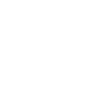

In [108]:
shapely.wkt.loads(df["geometry"].iloc[0])

<AxesSubplot:>

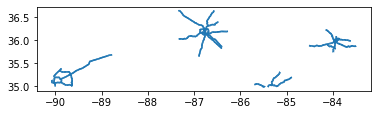

In [111]:
def parse_geometry(x):
    import shapely.wkt
    return shapely.wkt.loads(x["geometry"])

def parse_columns(x):
    from ast import literal_eval
    x['path'] = literal_eval(x['path'])
    x['color_lottr'] = tuple(map(float, x['color_lottr'].strip('()').split(', ')))
    return x

# geometry = df.apply(parse_geometry, axis=1)
df = df.apply(parse_columns, axis=1)
gdf = gpd.GeoDataFrame(df, crs="EPSG:4326", geometry=geometry)
gdf.plot()

In [113]:
path_layer = pdk.Layer(
    type="PathLayer",
    data=gdf,  # final_df
    get_path="path",
    # get_color=GET_COLOR_JS,
    # width_scale=10,
    width_min_pixels=4,
    get_color="color_lottr",
    auto_highlight=True,
    pickable=True,
    filled=True,
    opacity=0.8
)
# set tooltip
tooltip = {'html': '<b>Elevation Value:</b> LOTTR: {elevation}',
           'style': {'color': 'white'}
          }
pdk.Deck(layers=[path_layer], initial_view_state=view_state,
         map_style='light',
         tooltip = tooltip
         ).to_html("geopandas_integration.html")